# Research Question 2 - Communities


Are Reddit users more prone to comment on submissions that they agree with wrt. climate change topics?
- Hypothesis: Yes - the hypothesis is that there is a tendency of observing echo-chambers occurs within a Reddit network of the Climate Change discussion. This will be based on finding communities within the network using the Louvain algorithm, and then perform qualitative experiments using visualizations and textual analysis on some of these found communities.

Before answering this Research Question (RQ) a selection of modules and useful functions will be imported.

*Some cells are commented out to not run plot functions like netwulf*

## 1) Import packages

In [1]:
# importing modules
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm
import json
from collections import Counter
import os 
from pathlib import Path
import random
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from PIL import Image

import community
import netwulf as nw
import networkx as nx
from networkx.readwrite import json_graph
from sklearn.feature_extraction.text import TfidfVectorizer, TfidfTransformer, CountVectorizer
from wordcloud import WordCloud#, ImageColorGenerator
import plotly.offline as pyo

In [2]:

# loading graph
def read_json_file(filename):
    with open(filename) as f:
        js_graph = json.load(f)
    return json_graph.node_link_graph(js_graph)


# define plotting function
def LogLogPlot(data, xlabel='', ylabel = '', title='', figsize=((8,3)), dpi=200, path=None):
    min_val, max_val = (min(data), max(data))
    
    # compute bins
    log_bins = np.logspace(min_val if min_val == 0 else np.log10(min_val), np.log10(max_val), 101)
    lin_bins = np.linspace(min_val, max_val, 101)

    # create histogram values
    hist_log, edges_log = np.histogram(data.values, log_bins, density=True)
    hist_lin, edges_lin = np.histogram(data.values, lin_bins)

    # determine x-values
    log_x = (edges_log[1:] + edges_log[:-1]) / 2.
    lin_x = (edges_lin[1:] + edges_lin[:-1]) / 2.

    xx, yy = zip(*[(i,j) for (i,j) in zip(log_x, hist_log) if j > 0])
    
    # plot figure
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=figsize, dpi=dpi)

    # linear scale plot
    ax[0].plot(lin_x, hist_lin, marker='.', alpha=0.5)
    ax[0].set_xlabel(xlabel)
    ax[0].set_ylabel(ylabel)
    ax[0].set_title('linear scale')
    #ax[0].legend()

    # log-log scale plot
    ax[1].plot(xx, yy, marker='.', alpha=0.5)
    ax[1].set_yscale('log')
    ax[1].set_xscale('log')
    #ax[1].set_xscale('log')
    ax[1].set_xlabel(xlabel)
    ax[1].set_ylabel('probability density')
    ax[1].set_title('log-log scale')
    #ax[1].legend()
    fig.suptitle(title, fontsize=12)


    # show figure
    plt.tight_layout()
    plt.savefig(path)
    
    plt.show()
    return
    
# visualize a network
def visualize_graph(name, graph, coloring_attribute = None, num_samples = None, top_k_nodes=5, config = None, print_config = True):
    graph_copy = graph.copy()
    
    if num_samples is not None:
        graph_copy = graph_copy.subgraph(random.sample(graph_copy.nodes, num_samples))
        
    keep = ['group', 'weights', 'size']
    
    # calculating here since value might change if graph is a subgraph
    sorted_degrees = sorted(graph_copy.degree(weight='weight'), key=lambda x: x[1], reverse=True)
    degrees = dict(sorted_degrees)
    if coloring_attribute is not None:
        for k, v in graph_copy.nodes(data=True):
                        
            v['group'] = v[coloring_attribute]
            v['weights'] = 1
            v['size'] = degrees[k]
            
            #np.nansum([v['num_comments'], v['num_submissions']])
            for attr in list(v.keys()):
                if attr not in keep:
                #if coloring_attribute != attr:
                    del v[attr]
    #new_graph_copy = nw.get_filtered_network(graph_copy, node_group_key='group')
    
    network, config = nw.visualize(graph_copy, plot_in_cell_below=False, config = config)
    
    # print config if not defined
    if print_config:
        print('config file: \n')
        print(config)

    fig, ax = nw.draw_netwulf(network)
    # finding top k nodes baed on debrees
    top_nodes = list(list(zip(*sorted_degrees[:top_k_nodes]))[0])
    for node_id in top_nodes:
        nw.add_node_label(ax, network, node_id)
    
    fig.set_size_inches(18.5, 10.5)
    # save figure
    plt.savefig(f'{DATA_DIR / name}.jpg')
    return
    
# word cloud using tf idf
def generateWordCloud(freqs, color_func, save):
    # dictionary of {word: tfidf-score}
    #freqs = TFIDF[label]

    # Create and generate a word cloud image:
    
    wordcloud = WordCloud(width=700, height=300, max_font_size=50, max_words=100, background_color="white")
    wordcloud = wordcloud.generate_from_frequencies(freqs)

    # Display the generated image:
    #default_colors = wordcloud.to_array()
    fig = plt.figure(figsize=(20,10), dpi = 400)
    plt.imshow(wordcloud.recolor(color_func=color_func, random_state=3), interpolation='bilinear')
    plt.axis("off")
    plt.tight_layout(pad=0)
    plt.show()
    
    # save image
    name = 'data/figs/rq2/wc_com_' + save + '.png'
    wordcloud.to_file(name)
    return
    
    
# function to plot all wordcloud images above
def plot_wc_all_four(save_list, rocs, com_to_reason, extra = ''): 
    # opening images
    img1 = Image.open(save_list[0])
    img2 = Image.open(save_list[1])
    img3 = Image.open(save_list[2])
    img4 = Image.open(save_list[3])    
    
    matplotlib.rcParams['figure.dpi'] = 800


    
    
    sub_font_size = 8
    ax1 = plt.subplot(221)
    ax1.set_title(rocs[0], fontsize = sub_font_size)
    ax1.axis('off')
    ax1.imshow(img1)
    plt.savefig(f'{DATA_DIR / individ_name[0]}.jpg', bbox_inches='tight')



    ax2 = plt.subplot(222)
    ax2.set_title(rocs[1], fontsize = sub_font_size)
    ax2.axis('off')
    ax2.imshow(img2)
    plt.savefig(f'{DATA_DIR / individ_name[1]}.jpg', bbox_inches='tight')



    ax3 = plt.subplot(223)
    ax3.set_title(rocs[2], fontsize = sub_font_size)
    ax3.axis('off')
    ax3.imshow(img3)
    plt.savefig(f'{DATA_DIR / individ_name[2]}.jpg', bbox_inches='tight')



    ax4 = plt.subplot(224)
    ax4.set_title(rocs[3], fontsize = sub_font_size)
    ax4.axis('off')
    ax4.imshow(img4)
    plt.savefig(f'{DATA_DIR / individ_name[3]}.jpg', bbox_inches='tight')



    plt.suptitle('TF-IDF for each community {}'.format(extra), fontsize = 12)
    plt.tight_layout()

    name = './figs/rq2/wc_all_4' + extra
    plt.savefig(f'{DATA_DIR / name}.jpg')
    plt.show()

    
    
    
# function to plot all wordcloud images above
def save_wc_all_four_individ(save_list, rocs, com_to_reason, extra = ''): 
    # opening images
    img1 = Image.open(save_list[0])
    img2 = Image.open(save_list[1])
    img3 = Image.open(save_list[2])
    img4 = Image.open(save_list[3])

    individ_name = ['./figs/rq2/wc_{}_{}_{}'.format(com, com_to_reason[com], '_'+extra) for com in com_to_reason.keys()]

    img1 = Image.open(save_list[0])

    img2 = Image.open(save_list[1])

    img3 = Image.open(save_list[2])

    img4 = Image.open(save_list[3])

    matplotlib.rcParams['figure.dpi'] = 800


    sub_font_size = 8


    plt.imshow(img1)
    plt.title(rocs[0], fontsize = sub_font_size)
    plt.axis('off')
    plt.savefig(f'{DATA_DIR / individ_name[0]}.jpg', bbox_inches='tight')
    plt.close()

    plt.imshow(img2)
    plt.title(rocs[1], fontsize = sub_font_size)
    plt.axis('off')
    plt.savefig(f'{DATA_DIR / individ_name[1]}.jpg', bbox_inches='tight')
    plt.close()

    plt.imshow(img3)
    plt.title(rocs[2], fontsize = sub_font_size)
    plt.axis('off')
    plt.savefig(f'{DATA_DIR / individ_name[2]}.jpg', bbox_inches='tight')
    plt.close()

    plt.imshow(img4)
    plt.title(rocs[3], fontsize = sub_font_size)
    plt.axis('off')
    plt.savefig(f'{DATA_DIR / individ_name[3]}.jpg', bbox_inches='tight')
    plt.close()

    

In [3]:
# loading the climate graph
DATA_DIR = Path(os.path.dirname(os.getcwd())) / f'Reddit-ClimateGraph{os.sep}data'
years = ['2020'] # years to include
undirected = True
for year in years:
    # todo: adjust to be able to include multiple graphs
    # file must be unzipped
    filename = f'ClimateGraph-v2{os.sep + year + os.sep}ClimateGraph_{year}.json'
    climate_graph = read_json_file(f'{DATA_DIR / filename}')   
    if undirected == True:
        climate_graph = climate_graph.to_undirected()
print('...graph loaded successfully')

...graph loaded successfully


## 1) Short introduction

As explained in the explainer notebook, this analysis is restricted to the year of 2020.

### 1.1) Short example

As explained in the explainer notebook, this RQ will use the Reddit Climate Graph where nodes are redditors, and they are linked by submissions and comments but the graph will be converted to being undirected and not capture the relationship between a submission and its comments. The nodes contain meta-data in which the average opinion score and the processed text collection will be investigated. 

Below is a short summary of the graph:

In [4]:
print(climate_graph)
print('\n')
for node in climate_graph.nodes:
    print('Example of a nodes meta-data:\n', climate_graph.nodes[node])
    break

Graph with 64260 nodes and 75587 edges


Example of a nodes meta-data:
 {'text': '"BUILD  A BEACHE AND MAKE ATLANTIS PAY FOR IT"\n\npresidential candidate, probably.', 'all_awardings': [], 'total_awards_received': 0, 'score': 1, 'opinion_score': 0.0, 'first_comment': 1583193600, 'last_comment': 1583193600, 'first_submission': nan, 'last_submission': nan, 'num_comments': 1, 'num_submissions': nan, 'comment_controversiality': 0, 'tokens': {'build': 1, 'beach': 1, 'make': 1, 'atlanti': 1, 'pay': 1, 'presidenti': 1, 'candid': 1, 'probabl': 1}, 'processed_text': 'build beach make atlanti pay presidenti candid probabl', 'group': 0}


### 1.2) Generalizing the graph

In order to generalize more about the opinions of the redditors, each redditors opinion score will be categorized by a score of
* $[-1,-1/3]$ indicating a anti man-made climate change opinion.
* $]-1/3, 1/3[$ indicating a neutral opinion or news. 
* $[1/3,1]$ indicating a pro man-made climate change opinion.

These intervals are arbitrarily chosen and not based on any statistical test, but should rather split the interval $[-1,1]$ into three equally sized range of values. Based on these intervals every redditor will be assigned a color corresponding to:

* anti man-made climate change opinion: Red
* neutral climate change opinion or news: Beige
* pro man-made climate change opinion: Green

These colors should not bias the reader to e.g. associate red to being something negative, but could instead be thought of a traffic light based on a redditors man-made climate change opinion, by e.g. pro giving the green light and accepting it, yellow/beige intermediating and red stopping and not accepting such views.

In [5]:
# setting opinion values per node to binary and calculation weight vector
neutral = [-1/3, 1/3]
anit = [-1, neutral[0]]
pro = [neutral[1], 1]
# defining colors
colors = ['lightcoral', 'darkseagreen', 'papayawhip']
opins = ['anti', 'pro', 'neutral']
dict_colors = {}
for i, opin in enumerate(opins):
    dict_colors[opin] = colors[i]
    
# setting colored value to nodes based on opinion score
opin_scores = nx.get_node_attributes(climate_graph, "opinion_score")
os_colored = dict()
for k, v in opin_scores.items():
    if neutral[0] < v < neutral[1]:
        os_colored[k] = colors[2]
    elif anit[0] <= v <= anit[1]:
        os_colored[k] = colors[0]
    else: # it is pro
        os_colored[k] = colors[1]
nx.set_node_attributes(climate_graph, os_colored, "os_colored")

## 2) Visualizing the opinion based graph

The previously explained Reddit Climate Graph is visualized and colored based on the definitions above. The size of the nodes is defined by their number of degree and the top 10 largest nodes (with the highest degree) are also visualized with the corresponding redditors username.

In [6]:
'''
matplotlib.rcParams['figure.dpi'] = 400

# plotting using netwulf
config = {'zoom': 0.6, 'node_charge': -36.25176803394625, 'node_gravity': 0.8004243281471004, 
          'link_distance': 15, 'link_distance_variation': 0, 'node_collision': True, 
          'wiggle_nodes': False, 'freeze_nodes': False, 'node_fill_color': '#79aaa0', 
          'node_stroke_color': '#555555', 'node_label_color': '#000000', 'display_node_labels': False, 
          'scale_node_size_by_strength': True, 'node_size': 50, 'node_stroke_width': 0.4908062234794908, 
          'node_size_variation': 0.4, 'link_color': '#7c7c7c', 'link_width': 0.6674893917963225, 
          'link_alpha': 0.5, 'link_width_variation': 0.5, 'display_singleton_nodes': False, 
          'min_link_weight_percentile': 0, 'max_link_weight_percentile': 1}
# visualizing
visualize_graph(name = './figs/rq2/full_network', graph = climate_graph, 
                coloring_attribute = 'os_colored', top_k_nodes=10, num_samples = None, config = config)
'''

# visualizing the netwulf graph
name = 'data/figs/rq2/full_network.jpg'
#display(Image.open(name))


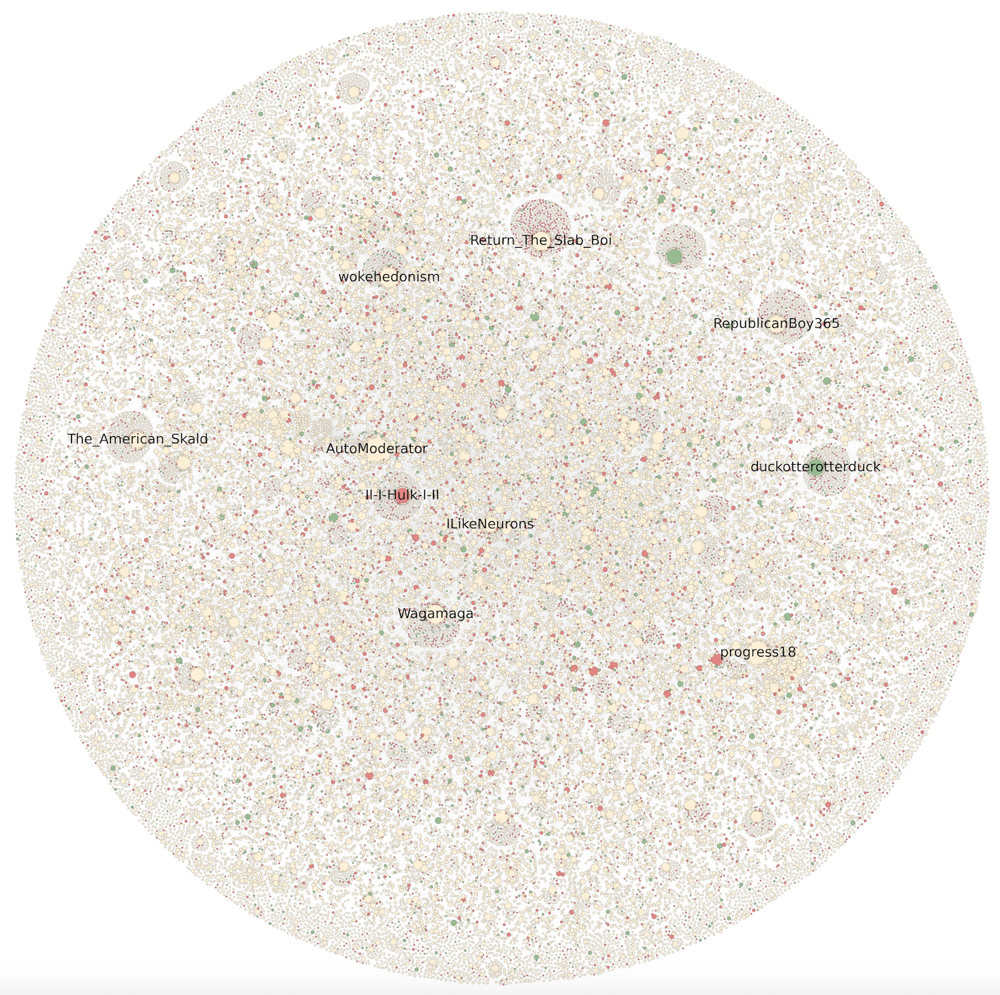

The graph is overly dominated by the beige color, e.g. a neutral opinion or news, this is also expected, since in the preliminary analysis the plot of the distribution of opinion scores had the highest frequencies around the 0 opinion score. However the other colors are therefore not fully excluded, and the top nodes contain the full defined color spectrum. What is interesting about the top nodes is that they are typically linked by a lot of other nodes with a small size, which might resemble a submission with a lot of commentators. This plot will play a role in how the qualitative investigation on communities is going to be performed.

## 3) Finding communities

When studying large networks such as social networks, there are typically a few different characteristics that commonly occur, and one of these characteristics is a community structure. A community structure is defined as groups of nodes that are more connected internally than the rest of the network, e.g. a submission and its comments as seen above. Since this RQ aims at investigating echo-chambers in the netwok, a social network community structure could naturally occur because of these echo-chambers, thus an algorithm called Louvain will be applied to the network to find these naturally occuring communities, and then these communities will be compared to the opinion of the nodes within it. The echo-chambers could then be indicated by a dominance of pro or anti opinions.


The Louvain method recursivly merges nodes together and performs a greedy optimization over the modularity measure. Modulairty measures the quality of a given partiton of the network, meaning a high modulairy indicates  densly nodes being connected to other nodes within their assigned community, but not to other nodes in the network. In short it measures the strength of division of a network, i.e. community structures. We use [the Python Louvain-algorithm implementation](https://anaconda.org/auto/python-louvain).

In [7]:
# finding communities using the Louvain algorithm
climate_partition = community.best_partition(climate_graph)

# finding type of communities and their count of nodes
communities_counter = Counter(climate_partition.values())

# sorted
sorted_community_sizes = sorted(list(communities_counter.values()), reverse=True)
num_communities = len(sorted_community_sizes)
print('Number of communities found by Louvain: ', num_communities)
print('Compared to the total number of nodes: 64260')

Number of communities found by Louvain:  8705
Compared to the total number of nodes: 64260


In [8]:
print('Modulairy based on the Louvain split: ', community.modularity(climate_partition, climate_graph))

Modulairy based on the Louvain split:  0.9231485296877983


In [9]:
os_colored = nx.get_node_attributes(climate_graph, "os_colored")
print('Modulairy based on the opinion score split: ', community.modularity(os_colored, climate_graph))

Modulairy based on the opinion score split:  0.00817024259338335


The modularity of the Louvain partiton is very high compared to the opinion partitionbeing closer to 0 with 0 indicating an undivided network. However, the opinion partition only split the network in three communities and is therefor a vague generalization of the network, but at the least means that the climate graph network is not entirely echo-chambers.

Visualizing the communities and their sized below.

In [10]:
# plotting


name = './figs/rq2/sizes_all'
path = f'{DATA_DIR / name}.jpg'

'''
# to create the plot
LogLogPlot(pd.Series(sorted_community_sizes).sort_values(ascending=True), 
           xlabel='communitiy sizes', ylabel = 'count of communities', title='Communities and their sizes',
           figsize=((8,3)), dpi=400, path = path)


# plotting saved
img = Image.open(path)
plt.figure(figsize=(20,10), dpi = 400)
plt.axis("off")
plt.imshow(img);
'''

'\n# to create the plot\nLogLogPlot(pd.Series(sorted_community_sizes).sort_values(ascending=True), \n           xlabel=\'communitiy sizes\', ylabel = \'count of communities\', title=\'Communities and their sizes\',\n           figsize=((8,3)), dpi=400, path = path)\n\n\n# plotting saved\nimg = Image.open(path)\nplt.figure(figsize=(20,10), dpi = 400)\nplt.axis("off")\nplt.imshow(img);\n'

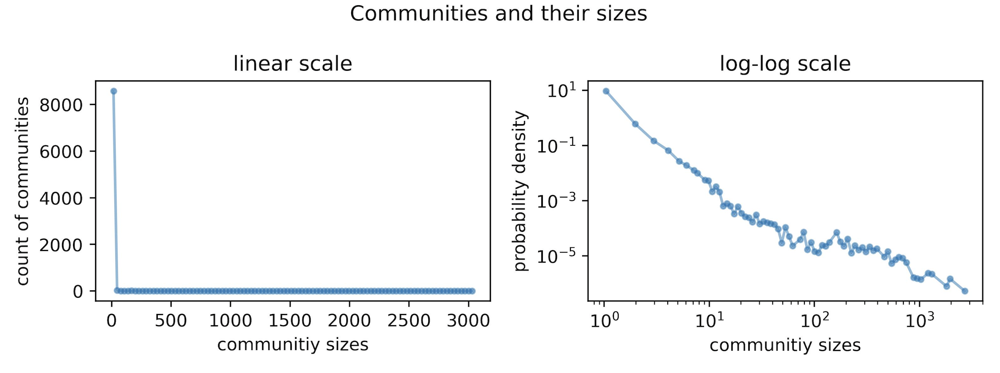

It is clearly visible that there are a lot of communities with a relativly small size, with the largest containing above 3000 nodes.

The qualitative studies will investigate textual content of the communities, which will work best if there is 'enough' text in the communities. Therefore an arbitrary choice of communities with a total of 80 nodes or lower will be excluded. This results in a lot of information loss and makes the investigation focus only on the larger communities, and if echo-chambers are mostly in smaller communities than of 80 nodes this choice would color the final conclusion of the RQ.

In [11]:
# finding the index of the community with a size of  # nodes
min_size = 80
not_found = True
while not_found:
    if min_size in sorted_community_sizes:
        print('With a minimum size of {} then {} communities are included out of {}'.format(min_size, sorted_community_sizes.index(min_size), len(sorted_community_sizes)))
        not_found = False
    else:
        min_size += 1

With a minimum size of 80 then 100 communities are included out of 8705


This mean only 100 communities are left

In [12]:
keep = 100


name = './figs/rq2/sizes_{}.png'.format(keep)
path = f'{DATA_DIR / name}.jpg'


'''
LogLogPlot(pd.Series(sorted_community_sizes[:keep]).sort_values(ascending=True), 
                xlabel='communitiy sizes', title='Communities and their sizes',
                figsize=((8,3)), dpi=300, path = path)


# plotting saved
img = Image.open(path)
plt.figure(figsize=(20,10), dpi = 400)
plt.axis("off")
plt.imshow(img);
'''

'\nLogLogPlot(pd.Series(sorted_community_sizes[:keep]).sort_values(ascending=True), \n                xlabel=\'communitiy sizes\', title=\'Communities and their sizes\',\n                figsize=((8,3)), dpi=300, path = path)\n\n\n# plotting saved\nimg = Image.open(path)\nplt.figure(figsize=(20,10), dpi = 400)\nplt.axis("off")\nplt.imshow(img);\n'

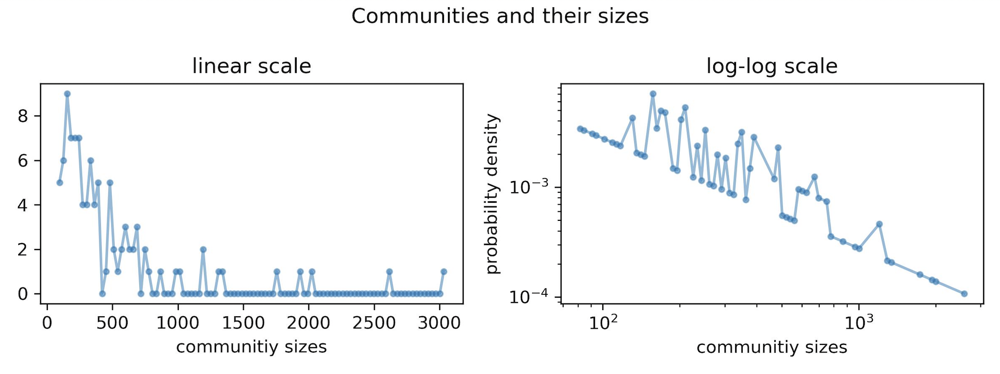

All the smaller communities have been removed. Doing this on the graph.

In [13]:
# removing small communities
# adding community attribute to nodes
nx.set_node_attributes(climate_graph, climate_partition, "communities")
new_climate_graph = climate_graph.copy()
# finding most common of how many to keep
most_common = dict(communities_counter.most_common(keep)).keys()
# removing
to_remove = []
for k, v in climate_partition.items():
    if v not in most_common:
        to_remove.append(k)
        
new_climate_graph.remove_nodes_from(to_remove)

In [14]:
print('before: ', climate_graph)
print('after: ', new_climate_graph)

print('\nWe have removed {} nodes which is {}%'.format(len(climate_graph.nodes)-len(new_climate_graph.nodes),
                                                     100*(1-len(new_climate_graph.nodes)/len(climate_graph.nodes))))

before:  Graph with 64260 nodes and 75587 edges
after:  Graph with 48111 nodes and 67397 edges

We have removed 16149 nodes which is 25.130718954248366%


Removing communities of size 80 or less has removed around 25 % of the nodes in the network. This is relativly small considering only 100 of the around 8700 communities have been removed.

In [15]:
# visualizing the graph
'''
config = {'zoom': 0.6, 'node_charge': -36.25176803394625, 'node_gravity': 0.8004243281471004, 
          'link_distance': 15, 'link_distance_variation': 0, 'node_collision': True, 
          'wiggle_nodes': False, 'freeze_nodes': False, 'node_fill_color': '#79aaa0', 
          'node_stroke_color': '#555555', 'node_label_color': '#000000', 'display_node_labels': False, 
          'scale_node_size_by_strength': True, 'node_size': 45.9052333804809, 'node_stroke_width': 0.4908062234794908, 
          'node_size_variation': 0.41881188118811885, 'link_color': '#7c7c7c', 'link_width': 0.6674893917963225, 
          'link_alpha': 0.5, 'link_width_variation': 0.5, 'display_singleton_nodes': False, 
          'min_link_weight_percentile': 0, 'max_link_weight_percentile': 1}

visualize_graph(name = './figs/rq2/com_network', graph = new_climate_graph, 
                coloring_attribute = 'communities', num_samples = None, top_k_nodes=10, config = config, print_config = False)

'''

# visualizing the netwulf graph
name = 'data/figs/rq2/com_network.jpg'
#display(Image.open(name))


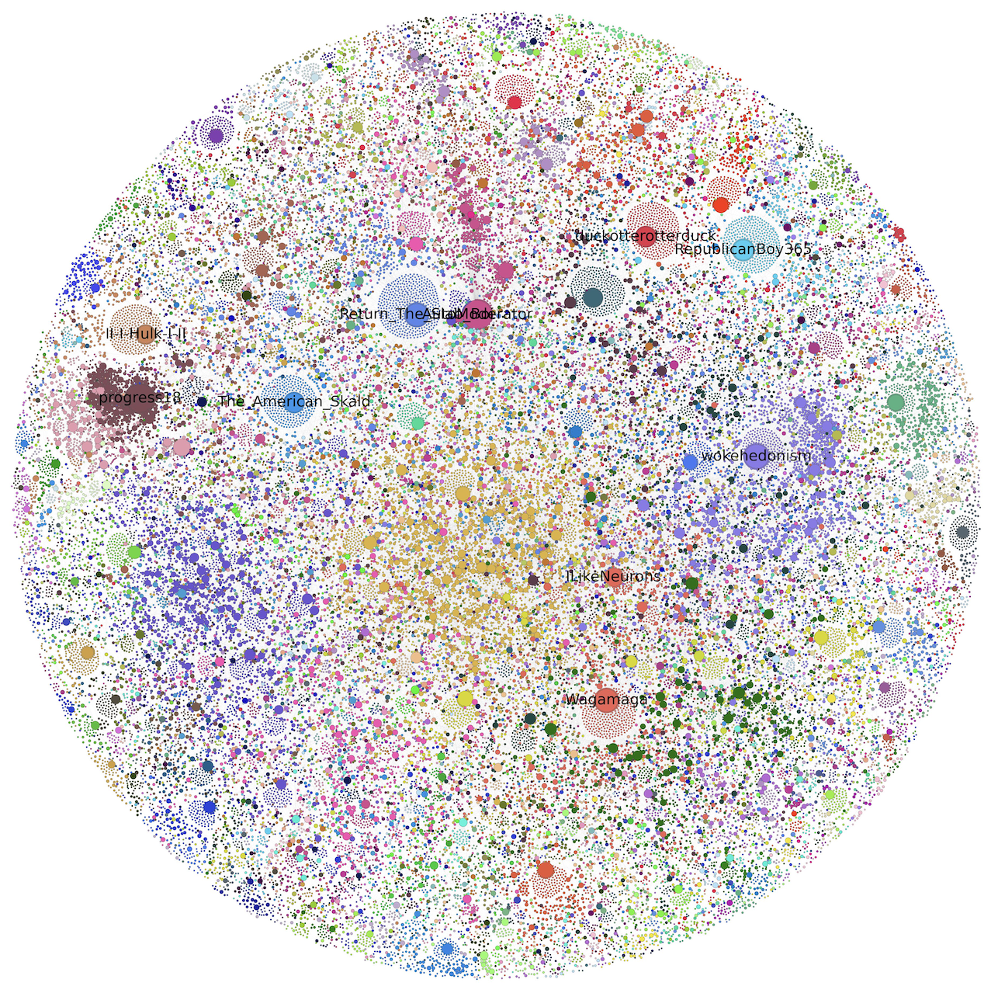

On a first note it is visible that the nodes with the highest degree (probably a populare submission) are generally considered as clusters, since that nodes hubs generally have a low degree, meaning they are more internally connected. However, there are also some clusters that look more scattered.

Since some of the smaller communities have been removed, the modularity based on opinion score is.

In [16]:
os_colored = nx.get_node_attributes(new_climate_graph, "os_colored")
print('Modulairy based on the opinion score split: ', community.modularity(os_colored, new_climate_graph))

Modulairy based on the opinion score split:  0.007685802844289433


This modularity is smaller with this filtering than when applied on the full graph, but that might be because many of the excluded communities mostly consist of very few nodes. Thus the modularity of the excluded communities is.


In [17]:

# removing large communities
# adding community attribute to nodes
nx.set_node_attributes(climate_graph, climate_partition, "communities")
new_climate_graph2 = climate_graph.copy()
# finding most common of how many to keep
most_common = list(dict(communities_counter.most_common()).keys())[keep:]
# removing
to_remove = []
for k, v in climate_partition.items():
    if v not in most_common:
        to_remove.append(k)
        
new_climate_graph2.remove_nodes_from(to_remove)

os_colored = nx.get_node_attributes(new_climate_graph2, "os_colored")
print('Modulairy based on the opinion score split: ', community.modularity(os_colored, new_climate_graph2))



Modulairy based on the opinion score split:  0.012330880000000028


This modularity score is a lot higher than the modularity of communities larger than 80, which might make it seem like echo-chambers are more present in smaller communities. However this might not be true, because considering the log-log plot of all the of the communities it clearly followed a powerlaw, thus we also see that...

In [18]:
# finding the index of the community with a size of  # nodes
min_size = 3
not_found = True
while not_found:
    if min_size in sorted_community_sizes:
        print('With a minimum size of {} then {} communities are included out of {}'.format(min_size, sorted_community_sizes.index(min_size), len(sorted_community_sizes)))
        not_found = False
    else:
        min_size += 1


With a minimum size of 3 then 799 communities are included out of 8705


Meaning the majority of the communities are very small, i.e. almost 8000 consist of only three nodes, and a conclusion that echo-chambers are generally the case in the climate discussion based on these small communities would not generalize it.

## 3) Communities and opinions

The climate graph has now been generalized based on opinions into three groups and split into communities found by the Louvain algorithm. These two attributes will know be compared to see if the communities are echo-chambers (e.g. consisting of mostly redditors with the same categorized opinion)

A confusion matrix is created based on communities found by the Louvain algorithm and the categorized opinion score.

In [19]:
most_common = list(dict(communities_counter.most_common()).keys())[:keep]


# finding partition keys
partition_color = nx.get_node_attributes(new_climate_graph, 'os_colored')
# finding uniques
partition_community = nx.get_node_attributes(new_climate_graph, 'communities')
communities = set(partition_community.values()) # louvain, each community has its own index
# most_common has the indices
labels = ['pro', 'anti', 'neutral']
# initializing matrix
D = np.zeros((len(labels), len(most_common)))

# for each type of partition, i.e. community
# can not overwrite name 'community'
for i, community in enumerate(most_common): # looping communities sorted by size (most common has indices)
    # filtering for louvain, finding nodes in this partition
    community_nodes = [k for k,v in partition_community.items() if v == community]
    # for each type of color
    for j, color in enumerate(list(colors)):
        # filtering for colors, finding nodes in this partition
        color_nodes = [k for k,v in partition_color.items() if v == color]
        # counting similar nodes
        D[j,i] = sum([1 for l in community_nodes if l in color_nodes])
df = pd.DataFrame(D, columns=most_common, index=labels)
print('Confusion matrix:')
display(df)

Confusion matrix:


,11,16,77,66,33,21,76,1,105,23,...,29,143,238,597,19,37,50,389,538,272
pro,258.0,607.0,220.0,159.0,165.0,184.0,108.0,142.0,136.0,275.0,...,15.0,2.0,14.0,5.0,14.0,4.0,6.0,10.0,4.0,3.0
anti,115.0,67.0,97.0,81.0,73.0,69.0,31.0,70.0,56.0,20.0,...,2.0,1.0,1.0,19.0,7.0,0.0,3.0,2.0,5.0,4.0
neutral,2725.0,1908.0,1673.0,1553.0,1399.0,1108.0,1139.0,1038.0,1010.0,776.0,...,120.0,127.0,114.0,104.0,97.0,114.0,104.0,71.0,74.0,74.0



In the confusion matrix above the columns are the Louvain communities and rows are the categorized opinion score splits. This matrix will be visualized and discussed below, where the values are instead bar plotted and also normalized.


In [20]:

name = './figs/rq2/bar_all_{}'.format(keep)
save = f'{DATA_DIR / name}.jpg'

matplotlib.rcParams['figure.dpi'] = 300
# transforming dataframe and normalizing
norm_df = df.T.apply(lambda x: x / x.sum(), axis=1)
# plotting the unnormalized


fig, axes = plt.subplots(nrows=2, ncols=1, sharex=True)
df.T.plot.bar(stacked=True, color = colors, figsize=(25,8), ax=axes[0], legend=False)
axes[0].set_ylabel('Opinion distribution');
# plotting the normalized
norm_df.plot.bar(stacked=True, color = colors, figsize=(25,8), ax=axes[1], legend=False)
axes[1].set_ylabel('% of opinion distribution');
fig.supxlabel('cluster index');
fig.suptitle('Distribution of opinions per community', fontsize=20);
fig.legend(labels, loc='center right', prop={'size': 20});

plt.close() # not opening file

'''
plt.savefig(save)
plt.show()


# visualizing the netwulf graph
display(Image.open(save))

'''


'\nplt.savefig(save)\nplt.show()\n\n\n# visualizing the netwulf graph\ndisplay(Image.open(save))\n\n'

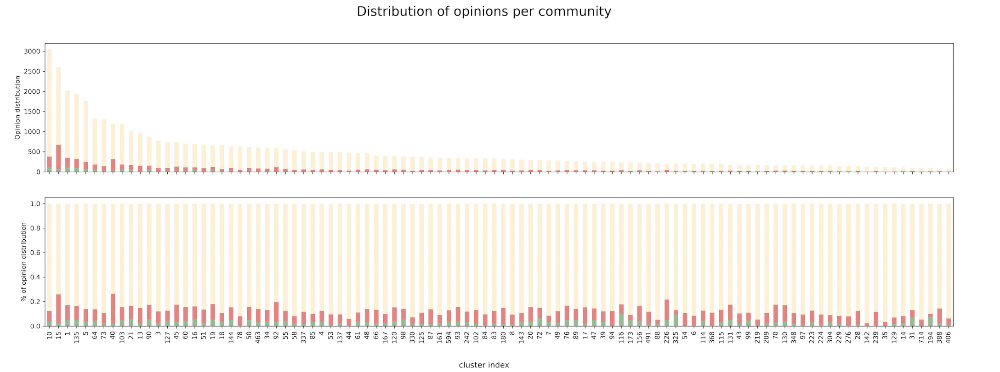

The above plot is based on the size of the communities and there is a big difference between the smallest and the largest. The plot below is normalized and indicated the distribution better. Again the dominance of authors in the neutral category in each community is visible, however only considering the pro/anti distribution there seem to be a trend that anti dominated the field. 


In general, none of the communities indicate echo-chambers of the pro/anti opinions.



## 4) Diving deeper into communities

The above plot showed an overview of top 100 largest the communities and their opinion distribution, but now some chosen communities will be investigated more closly. These chosen communities will amount to 4 where each will be found based on one the these critereas:

1. Neutral: Community with the largest proportion of neutral opinions.
2. Anti: Community with the largest proportion of anti opinions.
3. Pro: Community with the largest proportion of pro opinions.
4. Balanced: Community with the smallest difference between its anti and pro proportions.

These communities will be visualized based on their opinions as barplots and graphs (similar to above), and then also within their textual content.


### 4.1) Finding these communities

In [21]:
# finding indices 

find = 1 # how many communities to include

chosen_indices = [] # used in plot
reason = []
reason_to_com = {}
com_to_reason = {}
# for each opinion
for label in labels:
    reason_to_com[label] = []
    column = norm_df[label] # based on normalized
    
    # for number of defined communities to find
    for i in range(find):
        # finding max percentage value for this opinion across all column
        reason.append(label)
        max_index = column.idxmax()
        chosen_indices.append(max_index)
        reason_to_com[label].append(str(max_index))
        com_to_reason[str(max_index)] = label
        column = column.drop(max_index) # removing to not choose it again

# finding most balanced anti/pro communities
# removed community if it only consistes of neutrals
removed_ones = norm_df.loc[(norm_df['neutral']!=1)]
diff_column = removed_ones.apply(lambda x: abs(x['anti']-x['pro']), axis =1)
bal = 'balanced' # name

reason_to_com[bal] = []

finding = find
while finding != 0:
#for i in range(find):
    # finding max percentage value for this opinion across all column
    min_index = diff_column.idxmin()
    if min_index not in chosen_indices:
        reason.append(bal)
        chosen_indices.append(min_index)
        reason_to_com[bal].append(str(min_index))
        com_to_reason[str(min_index)] = bal
        finding -= 1
    diff_column = diff_column.drop(min_index) # removing to not choose it again

    
# setting balance community color
dict_colors[bal] = 'lightblue'


print('\nChosen communities: ', chosen_indices)
print('\nand their reasoning indices: ', reason)



Chosen communities:  [23, 597, 143, 42]

and their reasoning indices:  ['pro', 'anti', 'neutral', 'balanced']


### 4.2) Confusion matrix and bar plots

In [22]:
# filterting communities out
filtered_df = df.T.loc[df.columns.isin(chosen_indices), :]
filtered_norm_df = norm_df.loc[norm_df.T.columns.isin(chosen_indices), :]
# setting balance community color
print('The new confusion matrix:')
display(filtered_df.T)
print('normalized')
display(filtered_norm_df.T)

The new confusion matrix:


,23,42,143,597
pro,275.0,19.0,2.0,5.0
anti,20.0,16.0,1.0,19.0
neutral,776.0,246.0,127.0,104.0


normalized


,23,42,143,597
pro,0.256769,0.067616,0.015385,0.039062
anti,0.018674,0.056940,0.007692,0.148438
neutral,0.724556,0.875445,0.976923,0.812500


In [23]:
pyo.init_notebook_mode()

data = []
# finding communities for loop
coms = [str(com) for com in filtered_norm_df.index]
# finding reanson of choice of community for loop
reasoning = [com_to_reason[str(com)] for com in filtered_norm_df.index]
# looping each opinion
'''
for opin in filtered_norm_df.columns:
    # we are looping through opinions
    # name is current opinion, x are communities and y is the data for this opinion accross communities
    if opin == 'neutral':
        top_text = ['ROC: high on {}'.format(o) for o in reasoning]
    else:
        top_text = None
    data.append(go.Bar(name=opin, x=coms, y=list(np.around(np.array(filtered_norm_df[opin]),2)),
                                                 customdata=np.transpose([
                                                     filtered_df.apply(lambda x: x.sum(), axis=1),
                                                     filtered_df[opin],
                                                     list(np.around(100*np.array(filtered_norm_df[opin]),2)),
                                                     reasoning,
                                                     [opin]*len(coms)
                                                 ]),
                                                 marker_color=dict_colors[opin],
                                                 text = top_text,
                                                 textposition='outside',
                                                 hovertemplate='<br>'.join([
                                                     'community: %{x}',
                                                     'size of community: %{customdata[0]}',
                                                     #'reason of choice: high %{customdata[3]}',
                                                     'with this opinion: %{customdata[1]}',
                                                     'proportion: %{customdata[2]}%',
                                                 ])))

    
fig = go.Figure(data, layout_title_text='Distribution of opinions per community')
fig.update_layout(barmode='stack')
name = 'data/figs/rq2/bar_all_{}.html'.format(len(filtered_df.index))
fig.write_html(name, full_html=False, include_plotlyjs='cdn')

fig.show();

'''

"\nfor opin in filtered_norm_df.columns:\n    # we are looping through opinions\n    # name is current opinion, x are communities and y is the data for this opinion accross communities\n    if opin == 'neutral':\n        top_text = ['ROC: high on {}'.format(o) for o in reasoning]\n    else:\n        top_text = None\n    data.append(go.Bar(name=opin, x=coms, y=list(np.around(np.array(filtered_norm_df[opin]),2)),\n                                                 customdata=np.transpose([\n                                                     filtered_df.apply(lambda x: x.sum(), axis=1),\n                                                     filtered_df[opin],\n                                                     list(np.around(100*np.array(filtered_norm_df[opin]),2)),\n                                                     reasoning,\n                                                     [opin]*len(coms)\n                                                 ]),\n                                  

Saved bar-plot but not interactive:

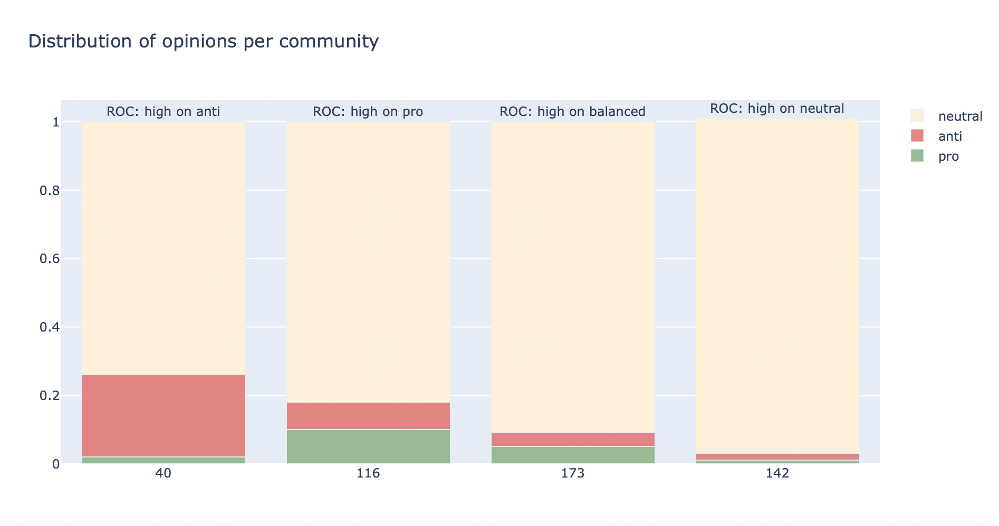

Note: ROC stands for reason of choice (i.e. for the respective community)

The distribution within each community and its ROC complement each other, but the large distribution of neutral in all cases does not indicate that these communities are echo-chambers.

### 4.2) Network graphs

Each of these four communities are now visualized.

In [24]:
com_to_reason

{'23': 'pro', '597': 'anti', '143': 'neutral', '42': 'balanced'}

In [25]:
# visualizing the individual graphs per community
'''
for com_idx, choice in com_to_reason.items():

    print('ROC: high on {}'.format(com_to_reason[com_idx]))

    name = './figs/rq2/nw_com_{}_{}'.format(com_idx, com_to_reason[com_idx])

    def filter_node(node):
        return partition_community[node] == int(com_idx) 

    g = nx.subgraph_view(new_climate_graph, filter_node=filter_node)
    config = {'zoom': 0.8783302464738567, 'node_charge': -70.87904259866079, 'node_gravity': 0.1, 'link_distance': 15, 'link_distance_variation': 0, 'node_collision': True, 'wiggle_nodes': False, 'freeze_nodes': False, 'node_fill_color': '#00b131', 'node_stroke_color': '#555555', 'node_label_color': '#000000', 'display_node_labels': False, 'scale_node_size_by_strength': False, 'node_size': 29.605356888445648, 'node_stroke_width': 1, 'node_size_variation': 0.5727311582846559, 'link_color': '#7c7c7c', 'link_width': 2, 'link_alpha': 0.5, 'link_width_variation': 0.5, 'display_singleton_nodes': True, 'min_link_weight_percentile': 0, 'max_link_weight_percentile': 1}
    # visualizing using netwulf
    #visualize_graph(name = name, graph = g, coloring_attribute = 'os_colored', num_samples = None, config = config, print_config=True)

    # if already saved
    path = f'{DATA_DIR / name}.jpg'
    # visualizing the netwulf graph
    #display(Image.open(path))

'''

"\nfor com_idx, choice in com_to_reason.items():\n\n    print('ROC: high on {}'.format(com_to_reason[com_idx]))\n\n    name = './figs/rq2/nw_com_{}_{}'.format(com_idx, com_to_reason[com_idx])\n\n    def filter_node(node):\n        return partition_community[node] == int(com_idx) \n\n    g = nx.subgraph_view(new_climate_graph, filter_node=filter_node)\n    config = {'zoom': 0.8783302464738567, 'node_charge': -70.87904259866079, 'node_gravity': 0.1, 'link_distance': 15, 'link_distance_variation': 0, 'node_collision': True, 'wiggle_nodes': False, 'freeze_nodes': False, 'node_fill_color': '#00b131', 'node_stroke_color': '#555555', 'node_label_color': '#000000', 'display_node_labels': False, 'scale_node_size_by_strength': False, 'node_size': 29.605356888445648, 'node_stroke_width': 1, 'node_size_variation': 0.5727311582846559, 'link_color': '#7c7c7c', 'link_width': 2, 'link_alpha': 0.5, 'link_width_variation': 0.5, 'display_singleton_nodes': True, 'min_link_weight_percentile': 0, 'max_link_

In [26]:
# creating the a list of saved paths to the graphs
nw_save_list = []
for com in com_to_reason.keys():
    nw_save_list.append('data/figs/rq2/nw_com_{}_{}.jpg'.format(com, com_to_reason[com]))
print(nw_save_list)

['data/figs/rq2/nw_com_23_pro.jpg', 'data/figs/rq2/nw_com_597_anti.jpg', 'data/figs/rq2/nw_com_143_neutral.jpg', 'data/figs/rq2/nw_com_42_balanced.jpg']


In [27]:
'''
rocs = ['{}: high on {}'.format(com, com_to_reason[com]) for com in com_to_reason.keys()]

name = './figs/rq2/nw_all_coms'
individ_name = ['./figs/rq2/nw_{}_{}'.format(com, com_to_reason[com]) for com in com_to_reason.keys()]




img1 = Image.open(nw_save_list[0])

img2 = Image.open(nw_save_list[1])

img3 = Image.open(nw_save_list[2])

img4 = Image.open(nw_save_list[3])

#fig, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=2, ncols=2,
#                          sharex=True, figsize=(8,10))

matplotlib.rcParams['figure.dpi'] = 800


sub_font_size = 8
ax1 = plt.subplot(221)
ax1.set_title(rocs[0], fontsize = sub_font_size)
ax1.axis('off')
ax1.imshow(img1)
plt.savefig(f'{DATA_DIR / individ_name[0]}.jpg', bbox_inches='tight')



ax2 = plt.subplot(222)
ax2.set_title(rocs[1], fontsize = sub_font_size)
ax2.axis('off')
ax2.imshow(img2)
fig.savefig(f'{DATA_DIR / individ_name[1]}.jpg', bbox_inches='tight')



ax3 = plt.subplot(223)
ax3.set_title(rocs[2], fontsize = sub_font_size)
ax3.axis('off')
ax3.imshow(img3)
plt.savefig(f'{DATA_DIR / individ_name[2]}.jpg', bbox_inches='tight')



ax4 = plt.subplot(224)
ax4.set_title(rocs[3], fontsize = sub_font_size)
ax4.axis('off')
ax4.imshow(img4)
plt.savefig(f'{DATA_DIR / individ_name[3]}.jpg', bbox_inches='tight')



plt.suptitle('Graph network for each community', fontsize = 12)
#plt.tight_layout()
plt.savefig(f'{DATA_DIR / name}.jpg')

plt.show()

# now individually


# saving all individually
rocs = ['{}: high on {}'.format(com, com_to_reason[com]) for com in com_to_reason.keys()]
individ_name = ['./figs/rq2/nw_{}_{}'.format(com, com_to_reason[com]) for com in com_to_reason.keys()]

img1 = Image.open(nw_save_list[0])

img2 = Image.open(nw_save_list[1])

img3 = Image.open(nw_save_list[2])

img4 = Image.open(nw_save_list[3])

matplotlib.rcParams['figure.dpi'] = 80


sub_font_size = 8


plt.imshow(img1)
plt.title(rocs[0], fontsize = sub_font_size)
plt.axis('off')
plt.savefig(f'{DATA_DIR / individ_name[0]}.jpg', bbox_inches='tight')
plt.close()

plt.imshow(img2)
plt.title(rocs[1], fontsize = sub_font_size)
plt.axis('off')
plt.savefig(f'{DATA_DIR / individ_name[1]}.jpg', bbox_inches='tight')
plt.close()

plt.imshow(img3)
plt.title(rocs[2], fontsize = sub_font_size)
plt.axis('off')
plt.savefig(f'{DATA_DIR / individ_name[2]}.jpg', bbox_inches='tight')
plt.close()

plt.imshow(img4)
plt.title(rocs[3], fontsize = sub_font_size)
plt.axis('off')
plt.savefig(f'{DATA_DIR / individ_name[3]}.jpg', bbox_inches='tight')
plt.close()
'''


"\nrocs = ['{}: high on {}'.format(com, com_to_reason[com]) for com in com_to_reason.keys()]\n\nname = './figs/rq2/nw_all_coms'\nindivid_name = ['./figs/rq2/nw_{}_{}'.format(com, com_to_reason[com]) for com in com_to_reason.keys()]\n\n\n\n\nimg1 = Image.open(nw_save_list[0])\n\nimg2 = Image.open(nw_save_list[1])\n\nimg3 = Image.open(nw_save_list[2])\n\nimg4 = Image.open(nw_save_list[3])\n\n#fig, (ax1, ax2, ax3, ax4) = plt.subplots(nrows=2, ncols=2,\n#                          sharex=True, figsize=(8,10))\n\nmatplotlib.rcParams['figure.dpi'] = 800\n\n\nsub_font_size = 8\nax1 = plt.subplot(221)\nax1.set_title(rocs[0], fontsize = sub_font_size)\nax1.axis('off')\nax1.imshow(img1)\nplt.savefig(f'{DATA_DIR / individ_name[0]}.jpg', bbox_inches='tight')\n\n\n\nax2 = plt.subplot(222)\nax2.set_title(rocs[1], fontsize = sub_font_size)\nax2.axis('off')\nax2.imshow(img2)\nfig.savefig(f'{DATA_DIR / individ_name[1]}.jpg', bbox_inches='tight')\n\n\n\nax3 = plt.subplot(223)\nax3.set_title(rocs[2], font

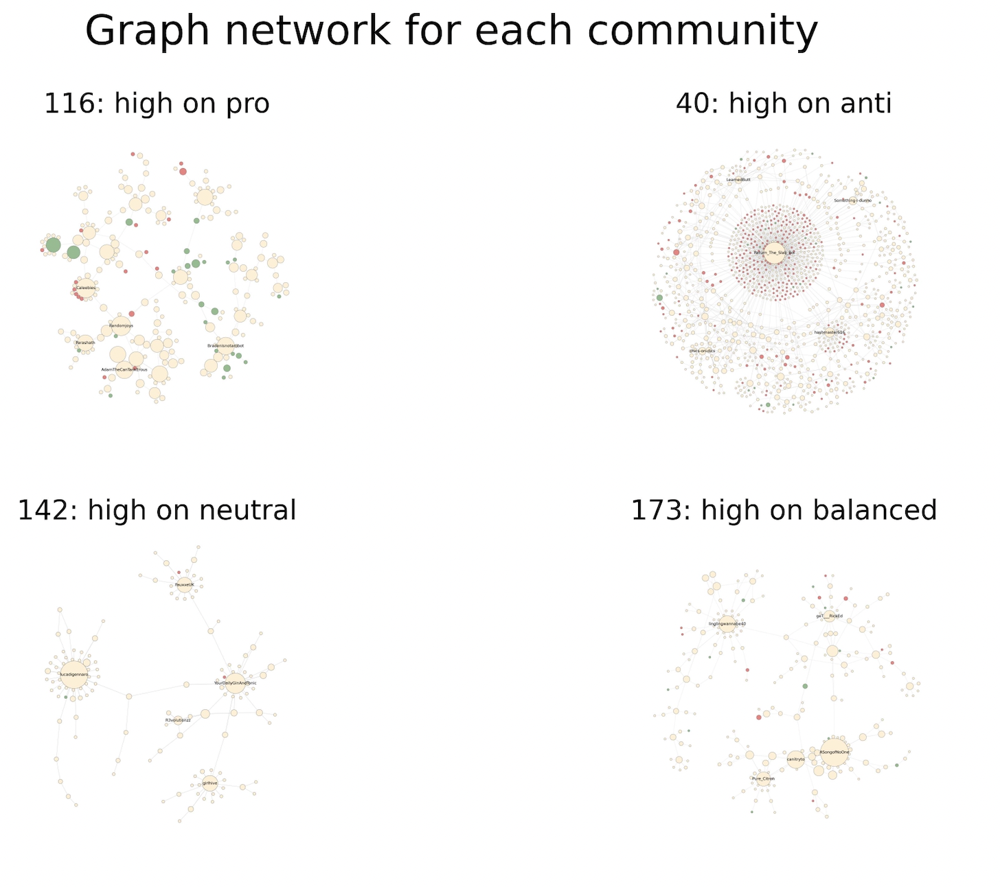

These graphs complement their ROC and they all seem distinct from each other, both in shape and size.

The community graph 'high on anti' looks to resembles something that could indicate an echo chamber, since the larger node has a lot of red colored nodes around itself. This could motivate investigating authorities and hubs to see if that could create echo-chambers or an authority could 'attach' followers with similar opinion.

### 4.3) TF-IDF: textual analysis

We further want to analyze which words are important within each community and see if these relate to certain minor topics of the Climate Change discussion. This will be done using a TF-IDF mapping of the textual content, since TF-IDF reflects the importance of words in a 'community' compared to a corpus collection of communities.

In TF-IDF each document corresponds to the sum of all the processed text of all the nodes within a community, and the corpus will be based upon all the top 100 communities.

In [28]:
# first for only the four chosen

corpus = {} # creating corpus here for textual analysis later
corpus_unique = {}
# for each opinion opinion
for opin, indices in reason_to_com.items():
    # for each community in opinion
    for com_idx in list(indices):
        # function to filter communities
        def filter_node(node):
            return partition_community[node] == int(com_idx) #?
        
        # filtering graph for community
        sub = nx.subgraph_view(new_climate_graph, filter_node=filter_node)

        corpus[com_idx] = ''
        # generating full corpus based on processed text
        for node in sub.nodes:
            corpus[com_idx] += sub.nodes[node]['processed_text']
        sub = None
        # using only unique words
        corpus_unique[com_idx] = ' '.join(list(set(corpus[com_idx].split(' '))))



In [29]:
# then for all 100 skipping first first 4
for com_idx in most_common:
    # for each community in opinion
    if com_idx not in list(reason_to_com.keys()):
        # function to filter communities
        def filter_node(node):
            return partition_community[node] == int(com_idx) #?
        
        # filtering graph for community
        sub = nx.subgraph_view(new_climate_graph, filter_node=filter_node)

        corpus[com_idx] = ''
        # generating full corpus based on processed text
        for node in sub.nodes:
            corpus[com_idx] += sub.nodes[node]['processed_text']
        corpus_unique[com_idx] = ' '.join(list(set(corpus[com_idx].split(' '))))
        sub = None

In [30]:
# tf idf for each community
'''
# pro

# initializing
all_corpus = [corpus[com] for com in corpus.keys()]
all_corpus_unique = [corpus_unique[com] for com in corpus_unique.keys()]


# chooseing document/community
i = 0

# method taken from: <https://towardsdatascience.com/tf-idf-explained-and-python-sklearn-implementation-b020c5e83275>
tfIdfVectorizer=TfidfVectorizer(use_idf=True)
tfIdf = tfIdfVectorizer.fit_transform(all_corpus)
tfIdf_df = pd.DataFrame(tfIdf[i].T.todense(), index=tfIdfVectorizer.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df = tfIdf_df.sort_values('TF-IDF', ascending=False)


tfIdfVectorizer2=TfidfVectorizer(use_idf=True)
tfIdf2 = tfIdfVectorizer2.fit_transform(all_corpus_unique)
tfIdf_df2 = pd.DataFrame(tfIdf2[i].T.todense(), index=tfIdfVectorizer2.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df2 = tfIdf_df2.sort_values('TF-IDF', ascending=False)

# colors found here on: <https://www.w3schools.com/html/html_colors_hsl.asp>
def green_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(142, %d%%, %d%%)" % (random.randint(60, 90), random.randint(20, 60))
# hsl(142, 75%, 58%)



print('Community: ', list(corpus.keys())[i])
print('Based on: ', com_to_reason[list(corpus.keys())[i]])
print('\nTOP 5:\n', tfIdf_df.head(10))


save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]]
#generateWordCloud(dict(tfIdf_df['TF-IDF']), color_func = green_color_func,  save = save)

print('\nwith unique:')
print('\nTOP 5:\n', tfIdf_df2.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]] + '_unique'
#generateWordCloud(dict(tfIdf_df2['TF-IDF']), color_func = green_color_func,  save = save)


# anti

i = 1
tfIdf_df = pd.DataFrame(tfIdf[i].T.todense(), index=tfIdfVectorizer.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df = tfIdf_df.sort_values('TF-IDF', ascending=False)

tfIdf_df2 = pd.DataFrame(tfIdf2[i].T.todense(), index=tfIdfVectorizer2.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df2 = tfIdf_df2.sort_values('TF-IDF', ascending=False)

def red_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(0, %d%%, %d%%)" % (random.randint(65, 90), random.randint(40, 70))

#hsl(0, 88%, 71%)

print('Community: ', list(corpus.keys())[i])
print('Based on: ', com_to_reason[list(corpus.keys())[i]])
print('\nTOP 5:\n', tfIdf_df.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]]
#generateWordCloud(dict(tfIdf_df['TF-IDF']), color_func = red_color_func, save = save)

print('\nwith unique:')
print('\nTOP 5:\n', tfIdf_df2.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]] + '_unique'
#generateWordCloud(dict(tfIdf_df2['TF-IDF']), color_func = red_color_func,  save = save)


# neutral

# hsl(36, 100%, 87%)

i = 2

tfIdf_df = pd.DataFrame(tfIdf[i].T.todense(), index=tfIdfVectorizer.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df = tfIdf_df.sort_values('TF-IDF', ascending=False)

tfIdf_df2 = pd.DataFrame(tfIdf2[i].T.todense(), index=tfIdfVectorizer2.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df2 = tfIdf_df2.sort_values('TF-IDF', ascending=False)

def beige_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(%i, %d%%, %d%%)" % (random.randint(25, 50), random.randint(80, 100), random.randint(75, 90))



print('Community: ', list(corpus.keys())[i])
print('Based on: ', com_to_reason[list(corpus.keys())[i]])
print('\nTOP 5:\n', tfIdf_df.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]]
#generateWordCloud(dict(tfIdf_df['TF-IDF']), color_func = beige_color_func, save = save)

print('\nwith unique:')
print('\nTOP 5:\n', tfIdf_df2.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]] + '_unique'
#generateWordCloud(dict(tfIdf_df2['TF-IDF']), color_func = beige_color_func,  save = save)


# balanced

i = 3

tfIdf_df = pd.DataFrame(tfIdf[i].T.todense(), index=tfIdfVectorizer.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df = tfIdf_df.sort_values('TF-IDF', ascending=False)


tfIdf_df2 = pd.DataFrame(tfIdf2[i].T.todense(), index=tfIdfVectorizer2.get_feature_names_out(), columns=["TF-IDF"])
tfIdf_df2 = tfIdf_df2.sort_values('TF-IDF', ascending=False)

def blue_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(206, %d%%, %d%%)" % (random.randint(75, 100), random.randint(50, 80))

# hsl(206, 100%, 70%)

print('Community: ', list(corpus.keys())[i])
print('Based on: ', com_to_reason[list(corpus.keys())[i]])
print('\nTOP 5:\n', tfIdf_df.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]]
#generateWordCloud(dict(tfIdf_df['TF-IDF']), color_func = blue_color_func, save = save)

print('\nwith unique:')
print('\nTOP 5:\n', tfIdf_df2.head(10))

save = list(corpus.keys())[i] + '_' +  com_to_reason[list(corpus.keys())[i]] + '_unique'
#generateWordCloud(dict(tfIdf_df2['TF-IDF']), color_func = blue_color_func,  save = save)
'''





'\n# pro\n\n# initializing\nall_corpus = [corpus[com] for com in corpus.keys()]\nall_corpus_unique = [corpus_unique[com] for com in corpus_unique.keys()]\n\n\n# chooseing document/community\ni = 0\n\n# method taken from: <https://towardsdatascience.com/tf-idf-explained-and-python-sklearn-implementation-b020c5e83275>\ntfIdfVectorizer=TfidfVectorizer(use_idf=True)\ntfIdf = tfIdfVectorizer.fit_transform(all_corpus)\ntfIdf_df = pd.DataFrame(tfIdf[i].T.todense(), index=tfIdfVectorizer.get_feature_names_out(), columns=["TF-IDF"])\ntfIdf_df = tfIdf_df.sort_values(\'TF-IDF\', ascending=False)\n\n\ntfIdfVectorizer2=TfidfVectorizer(use_idf=True)\ntfIdf2 = tfIdfVectorizer2.fit_transform(all_corpus_unique)\ntfIdf_df2 = pd.DataFrame(tfIdf2[i].T.todense(), index=tfIdfVectorizer2.get_feature_names_out(), columns=["TF-IDF"])\ntfIdf_df2 = tfIdf_df2.sort_values(\'TF-IDF\', ascending=False)\n\n# colors found here on: <https://www.w3schools.com/html/html_colors_hsl.asp>\ndef green_color_func(word, font_si

In [31]:
'''
# creating a saved list
wc_save_list = []
wc_save_list_unique = []
for com in com_to_reason.keys():
    wc_save_list.append('data/figs/rq2/wc_com_{}_{}.png'.format(com, com_to_reason[com]))
    wc_save_list_unique.append('data/figs/rq2/wc_com_{}_{}_unique.png'.format(com, com_to_reason[com]))
    
'''

"\n# creating a saved list\nwc_save_list = []\nwc_save_list_unique = []\nfor com in com_to_reason.keys():\n    wc_save_list.append('data/figs/rq2/wc_com_{}_{}.png'.format(com, com_to_reason[com]))\n    wc_save_list_unique.append('data/figs/rq2/wc_com_{}_{}_unique.png'.format(com, com_to_reason[com]))\n    \n"

In [32]:
# not doing unique

'''
rocs = ['{}: high on {}'.format(com ,com_to_reason[com]) for com in com_to_reason.keys()]

# not unique
plot_wc_all_four(wc_save_list, rocs, com_to_reason, extra = '')
save_wc_all_four_individ(wc_save_list, rocs, com_to_reason, extra = '')
'''

"\nrocs = ['{}: high on {}'.format(com ,com_to_reason[com]) for com in com_to_reason.keys()]\n\n# not unique\nplot_wc_all_four(wc_save_list, rocs, com_to_reason, extra = '')\nsave_wc_all_four_individ(wc_save_list, rocs, com_to_reason, extra = '')\n"

It is not possible to see if the communities are discussion a particular subject.

In [33]:
'''
# with unique
plot_wc_all_four(wc_save_list_unique, rocs, com_to_reason, extra = 'unique')
save_wc_all_four_individ(wc_save_list_unique, rocs, com_to_reason, extra = 'unique')
'''

"\n# with unique\nplot_wc_all_four(wc_save_list_unique, rocs, com_to_reason, extra = 'unique')\nsave_wc_all_four_individ(wc_save_list_unique, rocs, com_to_reason, extra = 'unique')\n"

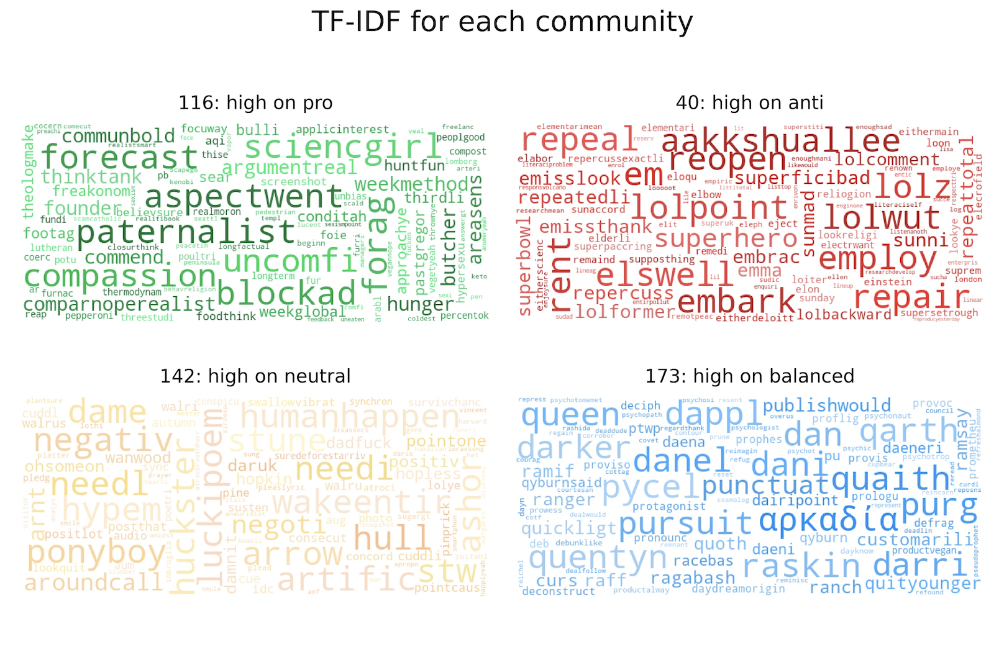

The previous plot could be disregarded, but this plot show a lot more of words that are unique to the specific community. 

* Comminity 116 seems to contain some of the subjects in the context of climate change like forage, poultry and butcher.

* Community 40 seems to have contrastive or reversed meaning words like repercuss, repeal, reopen, elswell (else well), aakkshuallee (actually) and eitherscienc (either science). But also climate change related words such as emisslook (e.g. emissions look), emissthank (e.g. emissions thanks). There does not seem to be a general topic even though the graph seemed to be a discussion in a submission.

* Community 142 contains words related to falsity such as huckster and artific (artificial) and then also related such as pointcaus (point of cause), wanwood, stune and humanhappen (human happen) which might seem climate change related but is hard to pinpoint.

* Community 173 does not have anything to do with climate change, since it actually seems to be redditors discussing Game of Thrones as most of the words are characters from there, thus this community should be disregarded from the analysis and conclusions.

One of the reasons no specific topic whitin the communites has been found, could be because some of them are based on multiple submissions and comments and seen by their graphs


## 5) Conclusion


In general all the nodes in the network and within the communities were classified and categorized with the opinion neutral or news, and this seemed 'color' the conclusions or observations, or at least make it hard to see some tendincies from start. Even in section 4) where communities should differ the most, neutral still dominated. 

No specific topics were found using TF-IDF except for community 173 wherein it was Game of Thrones, which is unrelated to the general topic climate change. However, the qualitative analysis of textual content and sub-graphs visualization could be extended upon to include more communities and look at the context of sentences rather than words.

When visualizing the full graph in the start, the top 10 nodes with the highest degree contained the full color spectrum, meaning all the opinions were present. This might make it interesting to investigate whether these top nodes (which could be viewed as authorities) can affeect their 'followers' (e.g. hubs) with their opinion, specifically community 40 seemed to be based on this structure and resembled something that could look like an echo-chamber.

To sum up, there was no trend of redditors being more prone to comment on submissions that they agree with wrt. climate change topics.


